In [3]:
import os
import sys
import pytz
import numpy as np
import umap
import plotly.express as px

current_path = os.getcwd()
src_path = os.path.abspath(os.path.join(current_path, '..', 'src', 'Python'))
sys.path.insert(0, src_path) 
from feature_extraction import *
from feature_generation import *

In [4]:
%load_ext autoreload
%autoreload 2

# Takeaways:
1. Maybe in addition to focusing on accuracy, we can look into how well the features cluster into 4 categories (or maybe it's more/less?) using UMAP for dimensional reduction  https://umap-learn.readthedocs.io/en/latest/basic_usage.html

# Features

## Heart Rate
- Heart Rate
- Heart rate 30 second mean
- Heart rate 30 second standard deviation
- Heart rate very low frequency (0.01 - 0.05 Hz)
- Heart rate VLF power standard deviation
## Movement & Pressure
- Pressure 30 second mean
- Pressure 30 second standard deviation
- Overall Dynamic Body Acceleration (ODBA) 30 second mean
- ODBA 30 second standard deviation
- GyroZ 30 second mean
- GyroZ 30 second standard deviation
## EEG Features
- EEG 30 second standard deviation
- EEG 30 second IQR
- EEG 30 second skew
- EEG 30 second kurtosis
- EEG 30 second zero crossings
- EEG 30 second hjorth mobility
- EEG 30 second hjorth complexity
- Slow Delta power (0.4 - 1 Hz)
- Fast Delta power (1 - 4 Hz)
- Theta power (4 - 8 Hz)
- Alpha power (8 - 12 Hz)
- Sigma power (12 - 16 Hz)
- Beta power (16 - 30 Hz)
- Delta / Theta power
- Delta / Sigma power
- Delta / Beta power
- Alpha / Theta power
- Absolute power (0.4 - 30 Hz)
#### ones I don't really understand
- EEG permutation entropy
- EEG higuchi fractal dimension (is this like the mirror dimension from doctor strange)
- EEG petrosian fractal dimension

## Preprocessing

### Load EDF and EEG data

In [4]:
path_to_edf = '../data/01_processed-data/test12_Wednesday_05_ALL_PROCESSED.edf'
raw = mne.io.read_raw_edf(path_to_edf, include=['ECG_Raw_Ch1', 'EEG_ICA5', 'Pressure', 'ODBA', 'GyrZ'], preload=True)
info = raw.info

Extracting EDF parameters from /Users/michael/Desktop/capstone-seal-sleep/Seal-Sleep-Capstone/data/01_processed-data/test12_Wednesday_05_ALL_PROCESSED.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 158957499  =      0.000 ... 317914.998 secs...


In [5]:
eeg_data = raw.get_data('EEG_ICA5')[0].copy()

### Load labels

In [6]:
# Load labeled data
# Path to CSV with scored data
file_path = '../data/02_annotated-data/test12_Wednesday_06_Hypnogram_JKB_1Hz.csv'

# Load the CSV file into a DataFrame
df = pd.read_csv(file_path)
df['R.Time'] = pd.to_datetime(df['R.Time']).dt.tz_localize('America/Los_Angeles')
df['Sleep.Code'].value_counts(normalize=True)

Sleep.Code
Active Waking         0.456175
Quiet Waking          0.143221
HV Slow Wave Sleep    0.124564
Drowsiness            0.075781
Certain REM Sleep     0.072228
LV Slow Wave Sleep    0.071997
Putative REM Sleep    0.034134
Unscorable            0.021901
Name: proportion, dtype: float64

### Get recording start time

In [7]:
sfreq = info['sfreq']
edf_start_time = info['meas_date']
# Define the PST timezone
pst_timezone = pytz.timezone('America/Los_Angeles')
# Convert to datetime object in PST
if isinstance(edf_start_time, datetime.datetime):
    # If it's already a datetime object, just replace the timezone
    recording_start_datetime = edf_start_time.replace(tzinfo=None).astimezone(pst_timezone)
    # for some reason using .replace(tzinfo=...) does weird shit - offsets based of LMT instead of UTC and gets confusing
    # recording_start_datetime = edf_start_time.replace(tzinfo=pst_timezone)
elif isinstance(edf_start_time, (int, float)):
    # Convert timestamp to datetime in PST
    recording_start_datetime = pst_timezone.localize(datetime.datetime.fromtimestamp(edf_start_time))

## Get features

In [8]:
features_all = generate_features(path_to_edf)

Extracting EDF parameters from /Users/michael/Desktop/capstone-seal-sleep/Seal-Sleep-Capstone/data/01_processed-data/test12_Wednesday_05_ALL_PROCESSED.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 158957499  =      0.000 ... 317914.998 secs...
starting heart rate


/Users/michael/Desktop/capstone-seal-sleep/Seal-Sleep-Capstone/src/feature_extraction.py:279: RuntimeWarning: divide by zero encountered in double_scalars
  heart_rates = [60 / ((rpeaks_corrected[i+1] - rpeaks_corrected[i]) / fs) for i in range(len(rpeaks_corrected) - 1)]


Filled: 0
done

--------------------------------------------------
starting hr_mean / hr_std
done

--------------------------------------------------
starting vlf power


/Users/michael/Desktop/capstone-seal-sleep/Seal-Sleep-Capstone/src/feature_extraction.py:197: RuntimeWarning: divide by zero encountered in log
  delta_power = 10 * np.log(np.sum(power_spectrum[delta_freq_indices]) * freq_resolution / ref_power)


done

--------------------------------------------------
starting yasa features
done

--------------------------------------------------
NA Values:
 Time                                      0
Heart Rate                                0
Heart Rate Mean                          29
Heart Rate Std.Dev                       29
Heart Rate Very Low Frequency Power      29
Heart Rate VLF Power Std.Dev           3215
Pressure Mean                            29
Pressure Std.Dev                         29
ODBA Mean                                29
ODBA Std.Dev                             29
GyrZ Mean                                29
GyrZ Std.Dev                             29
yasa_time                                 0
yasa_eeg_std                             18
yasa_eeg_iqr                             18
yasa_eeg_skew                            18
yasa_eeg_kurt                            18
yasa_eeg_nzc                             18
yasa_eeg_hmob                            18
yasa_eeg_hcomp 

### subset to timeframe in the labeled data

In [9]:
# Data with target, drop start and end sections that aren't scored because sensors not set up yet or taking off
features_labeled = features_all[(features_all['Time'] >= df['R.Time'].min()) &
                               (features_all['Time'] <= df['R.Time'].max())]
features_labeled = features_labeled.set_index('Time', drop=True).drop('yasa_time', axis=1)
features_labeled[['Sleep.Num', 'Simple.Sleep.Code']] = df.set_index('R.Time', drop=True)[['Sleep.Num',
                                                                                          'Simple.Sleep.Code']]

## UMAP dimensionality reduction, colored by label

In [9]:
features_labeled = pd.read_csv('../output/Wednesday_features_v2_with_labels.csv', index_col=0)

In [10]:
features_labeled.columns

Index(['Heart Rate', 'Heart Rate Mean', 'Heart Rate Std.Dev',
       'Heart Rate Very Low Frequency Power', 'Heart Rate VLF Power Std.Dev',
       'Pressure Mean', 'Pressure Std.Dev', 'ODBA Mean', 'ODBA Std.Dev',
       'GyrZ Mean', 'GyrZ Std.Dev', 'yasa_eeg_std', 'yasa_eeg_iqr',
       'yasa_eeg_skew', 'yasa_eeg_kurt', 'yasa_eeg_nzc', 'yasa_eeg_hmob',
       'yasa_eeg_hcomp', 'yasa_eeg_sdelta', 'yasa_eeg_fdelta',
       'yasa_eeg_theta', 'yasa_eeg_alpha', 'yasa_eeg_sigma', 'yasa_eeg_beta',
       'yasa_eeg_dt', 'yasa_eeg_ds', 'yasa_eeg_db', 'yasa_eeg_at',
       'yasa_eeg_abspow', 'yasa_eeg_perm', 'yasa_eeg_higuchi',
       'yasa_eeg_petrosian', 'Sleep.Num', 'Simple.Sleep.Code'],
      dtype='object')

In [11]:
X_all = features_labeled.dropna().drop(['Sleep.Num', 'Simple.Sleep.Code'], axis=1)
y_all = features_labeled.dropna()[['Sleep.Num', 'Simple.Sleep.Code']]

In [12]:
X_umap = pd.DataFrame(
    umap.UMAP(random_state=42).fit_transform(X_all),
    columns=['UMAP1', 'UMAP2']
)

/Users/michael/anaconda3/lib/python3.10/site-packages/umap/umap_.py:1943: UserWarning: n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
/Users/michael/anaconda3/lib/python3.10/site-packages/sklearn/manifold/_spectral_embedding.py:274: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


In [13]:
labeled_umap = X_umap.copy(deep=True)
labeled_umap[['Sleep.Num', 'Simple.Sleep.Code']] = y_all.reset_index(drop=True)

In [14]:
px.scatter(labeled_umap, x='UMAP1', y='UMAP2', color='Simple.Sleep.Code')

# Recursive Feature Elimination - sklearn

In [37]:
from sklearn.feature_selection import RFECV
from sklearn.ensemble import RandomForestClassifier

In [52]:
rfe_params = {
    'criterion': 'log_loss',
    'max_depth': 8,
    'max_features': 'log2',
    'n_estimators': 50
}
est = RandomForestClassifier(**rfe_params)
rfe = RFECV(est)
rfe.fit(X_all, y_all['Simple.Sleep.Code'])

RFECV(estimator=RandomForestClassifier(criterion='log_loss', max_depth=8,
                                       max_features='log2', n_estimators=50))

In [54]:
rfe.ranking_

array([1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 3, 1, 1, 1])

In [151]:
included = rfe.support_
print('Included')
print(X_all.columns[included])
print()
print('Not Included')
print(X_all.columns[~included])

Included
Index(['Heart Rate', 'Heart Rate Mean', 'Heart Rate Std.Dev',
       'Heart Rate Very Low Frequency Power', 'Pressure Mean',
       'Pressure Std.Dev', 'ODBA Mean', 'ODBA Std.Dev', 'GyrZ Mean',
       'GyrZ Std.Dev', 'yasa_eeg_std', 'yasa_eeg_iqr', 'yasa_eeg_skew',
       'yasa_eeg_kurt', 'yasa_eeg_nzc', 'yasa_eeg_hmob', 'yasa_eeg_hcomp',
       'yasa_eeg_sdelta', 'yasa_eeg_fdelta', 'yasa_eeg_theta',
       'yasa_eeg_alpha', 'yasa_eeg_sigma', 'yasa_eeg_beta', 'yasa_eeg_dt',
       'yasa_eeg_ds', 'yasa_eeg_db', 'yasa_eeg_at', 'yasa_eeg_perm',
       'yasa_eeg_higuchi', 'yasa_eeg_petrosian'],
      dtype='object')

Not Included
Index(['Heart Rate VLF Power Std.Dev', 'yasa_eeg_abspow'], dtype='object')


## Manual RFE

In [172]:
included = list(X_all.columns)
included = [
    'Heart Rate', 'Heart Rate Mean', 'Heart Rate Std.Dev',
    'Heart Rate Very Low Frequency Power', 'Pressure Mean',
    'ODBA Std.Dev', 'yasa_eeg_nzc', 'yasa_eeg_hmob', 'yasa_eeg_hcomp',
    'yasa_eeg_sdelta', 'yasa_eeg_fdelta', 'yasa_eeg_theta',
    'yasa_eeg_alpha', 'yasa_eeg_sigma', 'yasa_eeg_beta', 'yasa_eeg_dt',
    'yasa_eeg_ds', 'yasa_eeg_db', 'yasa_eeg_at'
] # remove this once testing all of them
steps = []
X_1, X_2, y_1, y_2 = train_test_split(
    model_data.drop(['Sleep.Num', 'Simple.Sleep.Code'], axis=1),
    model_data['Simple.Sleep.Code'], shuffle=False, test_size=0.50
)
while len(included) > 1:
    current_cols = pd.Series(included)
    accuracies = []
    for col in current_cols:
        print(f'Testing {len(current_cols)} columns, Feature: ' + col, end='')
        
        loo_cols = current_cols[current_cols != col]
        col_mask = current_cols.isin(loo_cols)
        # leave one out model
        
        # train on first half, predict second half
        loo_model = RandomForestClassifier(**{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2',
                                              'n_estimators': 50})
        loo_model.fit(X_1[loo_cols], y_1)
        preds_2 = loo_model.predict(X_2[loo_cols])
        
        # train on second half, predict first half
        loo_model = RandomForestClassifier(**{'criterion': 'gini', 'max_depth': 10, 'max_features': 'log2',
                                              'n_estimators': 50})
        loo_model.fit(X_2[loo_cols], y_2)
        preds_1 = loo_model.predict(X_1[loo_cols])
        
        accuracy = (np.mean([
            np.mean(preds_1 == y_1),
            np.mean(preds_2 == y_2)
        ]))
        accuracies.append(accuracy)
        print(', Accuracy:', f'{accuracy:.3f}')
    print('-'*80, end='\n\n\n')
    remove_index = accuracies.index(max(accuracies))
    remove_col = current_cols[remove_index]
    steps.append({'Removed': remove_col, 'Columns': current_cols.tolist(), 'Accuracies': accuracies})
    included.pop(remove_index)

Testing 19 columns, Feature: Heart Rate, Accuracy: 0.611
Testing 19 columns, Feature: Heart Rate Mean, Accuracy: 0.634
Testing 19 columns, Feature: Heart Rate Std.Dev, Accuracy: 0.608
Testing 19 columns, Feature: Heart Rate Very Low Frequency Power, Accuracy: 0.613
Testing 19 columns, Feature: Pressure Mean, Accuracy: 0.563
Testing 19 columns, Feature: ODBA Std.Dev, Accuracy: 0.565
Testing 19 columns, Feature: yasa_eeg_nzc, Accuracy: 0.606
Testing 19 columns, Feature: yasa_eeg_hmob, Accuracy: 0.599
Testing 19 columns, Feature: yasa_eeg_hcomp, Accuracy: 0.586
Testing 19 columns, Feature: yasa_eeg_sdelta, Accuracy: 0.616
Testing 19 columns, Feature: yasa_eeg_fdelta, Accuracy: 0.602
Testing 19 columns, Feature: yasa_eeg_theta, Accuracy: 0.614
Testing 19 columns, Feature: yasa_eeg_alpha, Accuracy: 0.619
Testing 19 columns, Feature: yasa_eeg_sigma, Accuracy: 0.598
Testing 19 columns, Feature: yasa_eeg_beta, Accuracy: 0.610
Testing 19 columns, Feature: yasa_eeg_dt, Accuracy: 0.607
Testing 19

In [177]:
steps

[{'Removed': 'Heart Rate Mean',
  'Columns': ['Heart Rate',
   'Heart Rate Mean',
   'Heart Rate Std.Dev',
   'Heart Rate Very Low Frequency Power',
   'Pressure Mean',
   'ODBA Std.Dev',
   'yasa_eeg_nzc',
   'yasa_eeg_hmob',
   'yasa_eeg_hcomp',
   'yasa_eeg_sdelta',
   'yasa_eeg_fdelta',
   'yasa_eeg_theta',
   'yasa_eeg_alpha',
   'yasa_eeg_sigma',
   'yasa_eeg_beta',
   'yasa_eeg_dt',
   'yasa_eeg_ds',
   'yasa_eeg_db',
   'yasa_eeg_at'],
  'Accuracies': [0.6112121568500894,
   0.6341399032221062,
   0.6082558339461155,
   0.6131637927359552,
   0.5628994132597218,
   0.5648915757106432,
   0.6056694971086689,
   0.5991831530040234,
   0.5855283555563685,
   0.6162932704837403,
   0.6019324491972191,
   0.6141854543389379,
   0.6188830220304389,
   0.5983548933986323,
   0.6100751190368023,
   0.6071629011139209,
   0.6159742404293307,
   0.6231834599184163,
   0.6030457097347663]},
 {'Removed': 'yasa_eeg_dt',
  'Columns': ['Heart Rate',
   'Heart Rate Std.Dev',
   'Heart Rate Ver

## Random Forest Classifier

## Notes
This is only one seal, and they are in the lab on land only for first two days and sometimes in the water for the last two days; we need to figure out how to account for measured signals being smaller in the water vs on land

In [44]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

In [45]:
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_features': ['sqrt', 'log2', None],
    'max_depth' : [2, 8, 32, 64, None],
    'criterion' :['gini', 'entropy', 'log_loss']
}

In [66]:
from sklearn.preprocessing import StandardScaler
model_data = features_labeled.dropna()
X_test, X_train, y_test, y_train = train_test_split(
    StandardScaler().fit_transform(model_data.drop(['Sleep.Num', 'Simple.Sleep.Code'], axis=1)),
    model_data['Simple.Sleep.Code'], shuffle=False, test_size=0.50
)

### probably need to change the scoring metric for this to f1_weighted or something else

In [ ]:
rfc = RandomForestClassifier()
CV_rfc = GridSearchCV(estimator=rfc, param_grid=param_grid, scoring='f1_weighted', cv=5, verbose=1, n_jobs=8)
CV_rfc.fit(X_train, y_train)

In [68]:
#best_params_rf = CV_rfc.best_params_
best_params_rf = {
    'criterion': 'log_loss',
    'max_depth': 8,
    'max_features': 'log2',
    'n_estimators': 50
}
best_params_rf

{'criterion': 'log_loss',
 'max_depth': 8,
 'max_features': 'log2',
 'n_estimators': 50}

In [69]:
model_rf = RandomForestClassifier(**best_params_rf)
model_rf.fit(X_train, y_train)
preds_rf = model_rf.predict(X_test)

In [70]:
pd.Series(preds_rf).value_counts()

Active Waking    68356
Quiet Waking     27412
SWS              25754
Drowsiness       13319
REM              12254
Unscorable         215
Name: count, dtype: int64

In [71]:
y_test.value_counts()

Simple.Sleep.Code
Active Waking    46269
SWS              34305
Quiet Waking     24055
REM              23703
Drowsiness       17317
Unscorable        1661
Name: count, dtype: int64

In [72]:
from sklearn.metrics import confusion_matrix
def display_conf_matr_and_class_acc(y_true, y_predicted):
    # Overall accuracy
    print('-'*110 + '\nOverall accuracy:', '{0:.3f}'.format(np.mean(y_true == y_predicted)), sep='\t')
    # Confusion matrix
    print('-'*110 + '\nConfusion matrix')
    labels = np.unique(y_true)
    conf_matr = confusion_matrix(y_test, y_predicted, labels=labels)
    conf_matr = pd.DataFrame(conf_matr, columns='Predicted ' + labels, index='True ' + labels)
    display(conf_matr)
    
    # Class accuracies
    print('-'*110 + '\nClass Accuracies')
    class_accuracies = conf_matr.to_numpy().diagonal() / np.sum(conf_matr, axis=1)
    class_accuracies = pd.DataFrame(class_accuracies, columns=['Accuracy']).T[
        ['True Active Waking', 'True Quiet Waking', 'True Drowsiness', 'True SWS', 'True REM', 'True Unscorable']
    ]
    # get rid of the "True " prefix
    class_accuracies.columns = pd.Series(class_accuracies.columns).apply(lambda x: x[5:]).values 
    display(class_accuracies.round(3))
    print('-'*110)

In [73]:
display_conf_matr_and_class_acc(y_test, preds_rf)

--------------------------------------------------------------------------------------------------------------
Overall accuracy:	0.648
--------------------------------------------------------------------------------------------------------------
Confusion matrix


,Predicted Active Waking,Predicted Drowsiness,Predicted Quiet Waking,Predicted REM,Predicted SWS,Predicted Unscorable
True Active Waking,43437,581,1973,14,123,141
True Drowsiness,4025,8450,4254,0,588,0
True Quiet Waking,12223,2866,7720,589,657,0
True REM,594,279,11231,11510,89,0
True SWS,6585,1097,2185,141,24297,0
True Unscorable,1492,46,49,0,0,74


--------------------------------------------------------------------------------------------------------------
Class Accuracies


,Active Waking,Quiet Waking,Drowsiness,SWS,REM,Unscorable
Accuracy,0.939,0.321,0.488,0.708,0.486,0.045


--------------------------------------------------------------------------------------------------------------


### default RFC

In [ ]:
model_rf = RandomForestClassifier()
model_rf.fit(X_train, y_train)
preds_rf_default = model_rf.predict(X_test)

In [ ]:
display_conf_matr_and_class_acc(y_test, preds_rf_default)

## Plot features next to predictions

In [79]:
preds = pd.Series(preds_rf, index=y_test.index)

In [85]:
df['Simple.Sleep.Code'].value_counts()

Simple.Sleep.Code
Active Waking    134431
SWS               57925
Quiet Waking      42206
REM               31344
Drowsiness        22332
Unscorable         6454
Name: count, dtype: int64

In [140]:
colormap = {
    'Awake': 'lightcoral',
    'SW1': 'green',
    'SW2': 'cyan',
    'REM': 'gold',
    'Drowsy': 'mediumpurple'
}
eeg_start_sec = (features_labeled.index[0] - recording_start_datetime).total_seconds()
eeg_subset = eeg_data[int(eeg_start_sec * 500):]
def plot_nap(nap_start_dt, nap_end_dt):
    import matplotlib.dates as mdates
    eeg_start_idx = int((nap_start_dt - features_labeled.index[0]).total_seconds() * 500)
    eeg_end_idx = int((nap_end_dt - features_labeled.index[0]).total_seconds() * 500)
    fig, ax = plt.subplots(5, 1, figsize=(9, 8))
    nap_df = features_labeled[(features_labeled.index >= nap_start_dt) &
                              (features_labeled.index <= nap_end_dt)]
    print(eeg_start_idx, eeg_end_idx)
    eeg_nap = eeg_subset[eeg_start_idx:eeg_end_idx]
    labels_yaxis = pd.Series(['Unscorable', 'Active Waking', 'Quiet Waking', 'Drowsiness', 'SWS', 'REM'])
    labels_nap = pd.concat([labels_yaxis, nap_df['Simple.Sleep.Code'].copy()], ignore_index=True)
    preds_nap = pd.concat([labels_yaxis, preds[(preds.index >= nap_start_dt) & (preds.index <= nap_end_dt)]],
                          ignore_index=True)
    print('duration (seconds):', np.sum((preds.index >= nap_start_dt) & (preds.index <= nap_end_dt)))
    # Labels
    sns.lineplot(labels_nap, ax=ax[0], color='black')
    ax[0].set_yticks(labels_yaxis.values)
    ax[0].set_ylabel('True\nLabel')
    ax[0].set_xlim([len(labels_yaxis), len(labels_nap)])
    ax[0].yaxis.tick_right()
    # Predictions
    sns.lineplot(preds_nap, ax=ax[1], color='purple')
    ax[1].set_yticks(labels_yaxis.values)
    ax[1].set_ylabel('Predicted\nLabel')
    ax[1].set_xlim([len(labels_yaxis), len(preds_nap)])
    ax[1].yaxis.tick_right()
    # Delta Power
    sns.lineplot(nap_df['yasa_eeg_sdelta'] + nap_df['yasa_eeg_fdelta'], ax=ax[2], color='lightgreen')
    ax[2].set_ylabel('Delta Power')
    # EEG
    eeg_fig = sns.lineplot(eeg_nap, ax=ax[3], color='green')
    # plot two standard deviations from median
    eeg_median, eeg_std = np.median(eeg_nap), np.std(eeg_nap)
    print(eeg_median, eeg_std)

    ax[3].set_ylabel('EEG')
    # Heart rate
    sns.lineplot(nap_df['Heart Rate'], ax=ax[4], color='lightcoral')
    ax[4].xaxis.set_major_formatter(mdates.DateFormatter('%m/%d %H:%M'))
    # Pressure
    #sns.lineplot(nap_df['Pressure Mean'], ax=ax[5], color='lightblue')
    for i in range(len(ax) - 1):
        ax[i].set_xticks([])
        ax[i].set_xlabel('')
    ax[3].set_ylim(-7e-5, 7e-5)
    plt.subplots_adjust(wspace=0, hspace=0.3)
    yasa.plot_spectrogram(
        eeg_subset[eeg_start_idx:eeg_end_idx], 500,
        #hypno=np.array([[x] * 500 for x in features_v1['label'].apply(lambda x: hypno_map[x])]).flatten(),
        cmap='gnuplot'
    )
    plt.show()

3289000 3739000
duration (seconds): 901
1.5550748455020534e-06 9.335585952432235e-06


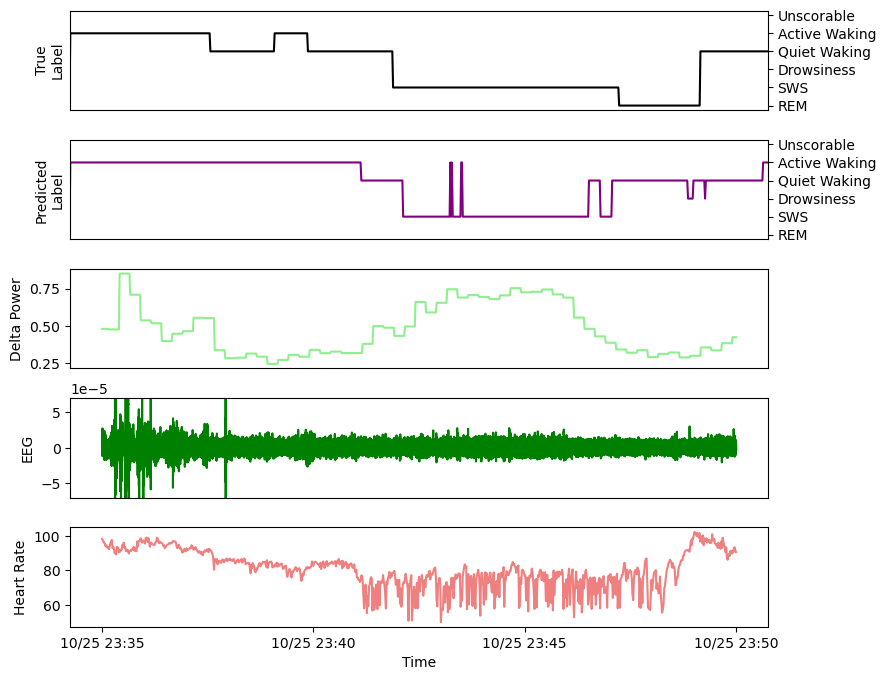

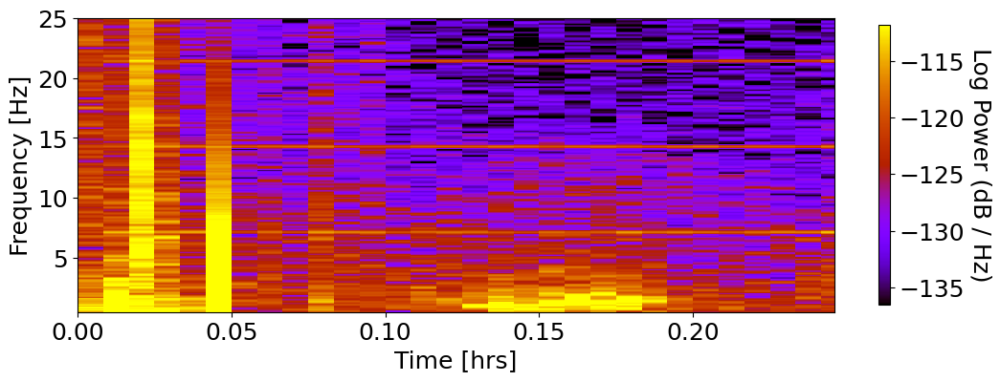

In [142]:
nap1 = (
    datetime.datetime.strptime('10/25/2019 16:35:00', '%m/%d/%Y %H:%M:%S').replace(tzinfo=None).astimezone(pst_timezone),
    datetime.datetime.strptime('10/25/2019 16:50:00', '%m/%d/%Y %H:%M:%S').replace(tzinfo=None).astimezone(pst_timezone)
)
plot_nap(nap1[0], nap1[1])


7629000 8014000
duration (seconds): 771
-8.036911574003191e-08 6.26838257998209e-06


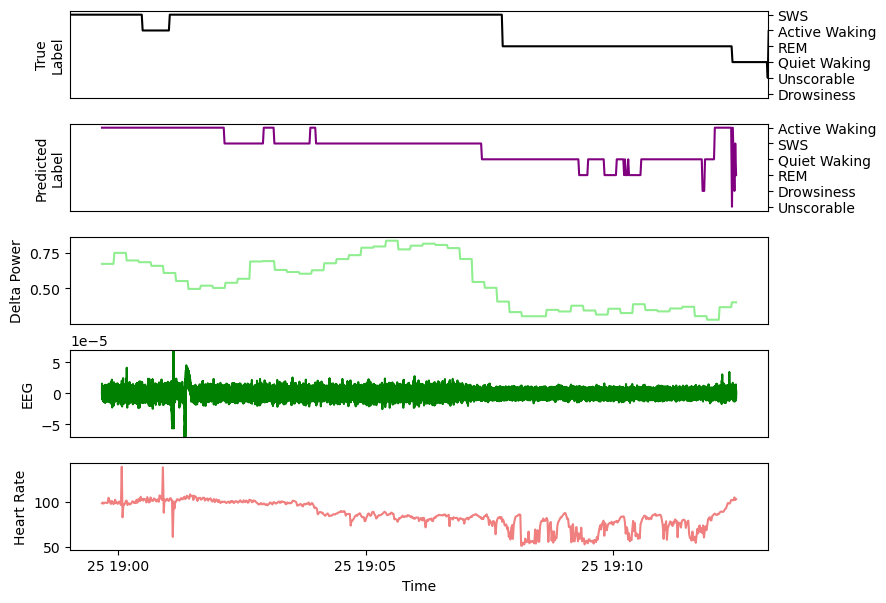

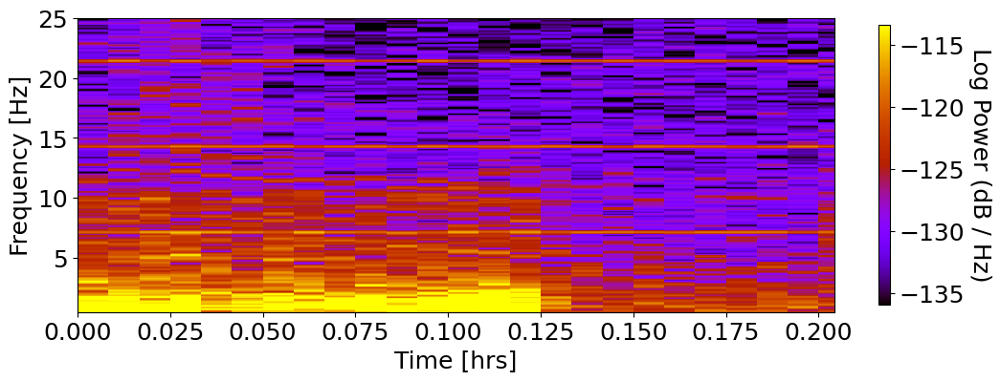

In [129]:
nap1 = (
    datetime.datetime.strptime('10/25/2019 18:59:40', '%m/%d/%Y %H:%M:%S').replace(tzinfo=None).astimezone(pst_timezone),
    datetime.datetime.strptime('10/25/2019 19:12:30', '%m/%d/%Y %H:%M:%S').replace(tzinfo=None).astimezone(pst_timezone)
)
plot_nap(nap1[0], nap1[1])


4819000 5149000
duration (seconds): 661
3.869005874719935e-07 4.631051375799833e-06


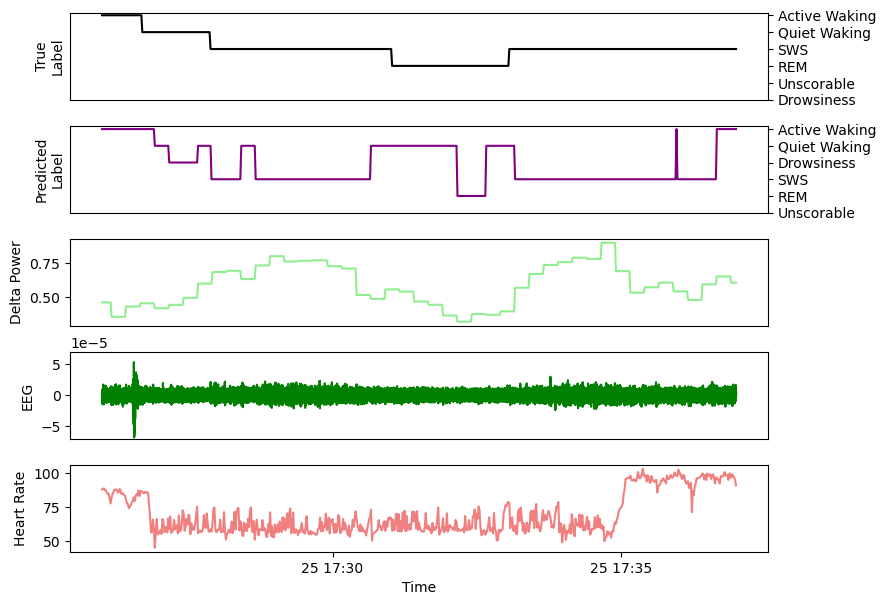

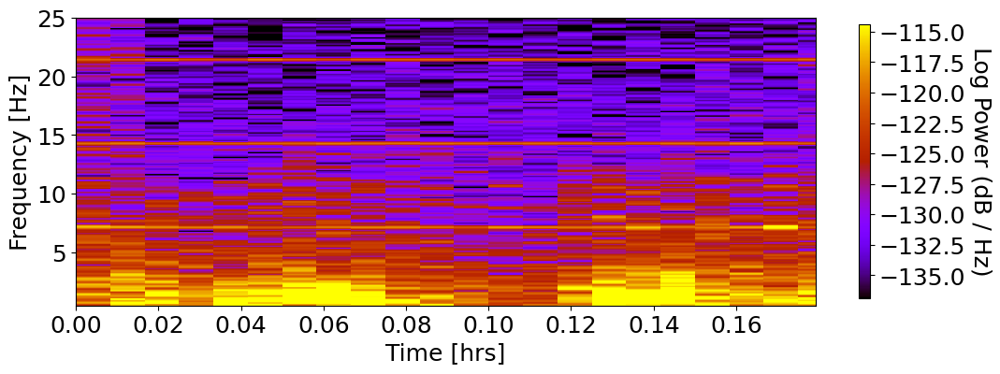

In [111]:
nap2 = (
    datetime.datetime.strptime('10/25/2019 17:26:00', '%m/%d/%Y %H:%M:%S').replace(tzinfo=None).astimezone(pst_timezone),
    datetime.datetime.strptime('10/25/2019 17:37:00', '%m/%d/%Y %H:%M:%S').replace(tzinfo=None).astimezone(pst_timezone)
)
plot_nap(nap2[0], nap2[1])


# Next steps:
- Recursive feature elimination to see which features are important and being used
- More features? Especially for detecting REM
- Tuning window sizes of existing features (heart rate mean/std, EEG feature epoch windows - delta power, etc)
- More advanced models? LightGBM, RNN, 1NN layer after a RFC or KNN, Bayesian probabilities of current label given previous label for smoothing
- HMM for movement: https://github.com/bmcclintock/momentuHMM

In [178]:
X_umap

,UMAP1,UMAP2
0,-9.145301,4.447937
1,-9.147105,4.451621
2,-9.146552,4.450627
3,9.190808,7.037905
4,9.193304,7.039418
...,...,...
294616,4.948154,-11.040928
294617,4.948792,-11.041576
294618,4.948950,-11.042448
294619,4.949612,-11.042659
